## Single Object - 54789

Here we fit asteroid (54789) from our gold sample of best-observed asteroids with 
different fitting configurations and assumptions on priors. 
 

In [1]:
# Repository locations
ATM_DIR = "/epyc/projects/atm/atm/"
ATM_DATA_DIR = "/epyc/projects/atm/atm_data/"

In [2]:
import os
import numpy as np
import pandas as pd
import sqlite3 as sql
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(font_scale=1.2, 
        context="paper", 
        style="ticks")

%matplotlib inline

import sys
sys.path.append(ATM_DIR)

from atm import modifyErrors
from atm import multiFit
from atm.models import NEATM
from atm.obs import WISE
from atm.analysis import postProcess
from atm.functions import calcFluxLambdaSED
from atm.functions import calcQ
from atm.plotting import plotObservations
from atm.plotting import plotSED

In [3]:
m_to_mum = 1e6 # simple conversion from m to micron
km_to_m = 1e3 # conversion km to m

In [4]:
DPI = 300
SAVE_DIR = "../plots/"
FORMAT = "png"

SAVE_FIGS = True

In [5]:
# Grab observations and additional data
con = sql.connect(os.path.join(ATM_DATA_DIR, "paper1/sample.db"))
observations = pd.read_sql("""SELECT * FROM observations""", con)
additional = pd.read_sql("""SELECT * FROM additional""", con)

# Only keep clipped observations
observations = observations[observations["keep"] == 1]
additional = additional[additional["obs_id"].isin(observations["obs_id"].values)]

# Remove missing H value, G value objects... 
observations = observations[~observations["designation"].isin(['2010 AJ104', '2010 BM69', '2010 DZ64', '2010 EL27', '2010 EW144',
   '2010 FE82', '2010 FJ48', '2010 HK10', '2010 LE80'])]

# Convert phase angle to radians
observations["alpha_rad"] = np.radians(observations["alpha_deg"])
ran_override = False

# Initialize observatory 
obs = WISE()

In [6]:
if ran_override == False:
    observations = modifyErrors(observations, obs, sigma=0.15)
    ran_override = True
else:
    print("No need to run this again!")

Added 0.15 magnitude errors to magErr_W1.
Added 0.15 magnitude errors to magErr_W2.
Added 0.15 magnitude errors to magErr_W3.
Added 0.15 magnitude errors to magErr_W4.
Converted magnitude errors to flux errors.
Updating fluxErr_W1_si with new error.
Updating fluxErr_W2_si with new error.
Updating fluxErr_W3_si with new error.
Updating fluxErr_W4_si with new error.
Done.



## Select asteroid and set sampling configuration

In [7]:
asteroid_name = "54789"

In [8]:
runDict = {}
dataDict = {}

fitConfig = {
        "chains" : 20,
        "samples" : 3000,
        "burnInSamples": 500,
        "threads": 20,
        "scaling": 0.01,
        "plotTrace" : True,
        "plotCorner" : True,
        "progressBar" : True,
        "figKwargs" : {"dpi" : DPI}
    }

data = observations[observations["designation"].isin([asteroid_name])]
data_additional = additional[additional["obs_id"].isin(data["obs_id"].values)] # Contains published magnitudes

In [9]:
data.head()

,obs_id,designation,r_au,delta_au,alpha_deg,H_mag,G,mjd,flux_W1_si,fluxErr_W1_si,...,mag_W1,magErr_W1,mag_W2,magErr_W2,mag_W3,magErr_W3,mag_W4,magErr_W4,keep,alpha_rad
66506,66507,54789,1.465148,0.982870,43.6433,15.,0.15,55349.938154,3.304949e-11,1.041038e-11,...,15.974,0.342,14.778,0.382,8.666,0.196,6.386,0.298,1,0.761719
66507,66508,54789,1.466093,0.984738,43.6129,15.,0.15,55350.202762,4.549512e-11,1.290599e-11,...,15.627,0.308,13.727,0.266,8.233,0.184,5.959,0.257,1,0.761189
66508,66509,54789,1.466565,0.985673,43.5977,15.,0.15,55350.334938,7.891596e-11,1.860718e-11,...,15.029,0.256,13.373,0.232,7.908,0.182,6.087,0.248,1,0.760923
66509,66510,54789,1.466566,0.985674,43.5977,15.,0.15,55350.335066,7.704861e-11,1.894749e-11,...,15.055,0.267,13.449,0.242,7.888,0.178,6.055,0.258,1,0.760923
66510,66511,54789,1.467038,0.986609,43.5825,15.,0.15,55350.467242,5.257325e-11,1.467179e-11,...,15.470,0.303,13.572,0.245,7.977,0.182,6.022,0.244,1,0.760658


In [10]:
data_additional.head()

,obs_id,ra_deg,ra_sigma_arcsec,ra_u,dec_deg,dec_sigma_arcsec,dec_u,radec_cosigma_arcsec,w1mpro,w1rchi2,...,w4sigmpro,w4snr,cc_flags,cntr_u,dist_x,pang_x,ph_qual,na,nb,sso_flg
66506,66507,186.758628,0.3087,186.758474,39.234399,0.3300,39.234273,0.0981,15.974,0.8017,...,0.148,7.3,0000,2,0.625582,43.524071,BBAB,0,1,1
66507,66508,186.904283,0.2247,186.904245,39.111018,0.2362,39.110906,0.0290,15.627,0.8207,...,0.107,10.1,0000,4,0.415689,14.874046,BBAA,0,1,1
66508,66509,186.977064,0.2205,186.976986,39.049267,0.1997,39.049259,0.0716,15.029,1.9250,...,0.098,11.0,0000,5,0.220988,82.134947,AAAA,0,1,1
66509,66510,186.977067,0.1870,186.977045,39.049228,0.1993,39.049168,-0.0394,15.055,0.7327,...,0.108,10.1,0000,6,0.226092,15.565224,BAAA,0,1,1
66510,66511,187.049762,0.2283,187.049729,38.987546,0.2131,38.987485,0.0661,15.470,0.8731,...,0.094,11.6,0000,7,0.238883,22.958750,BAAA,0,1,1


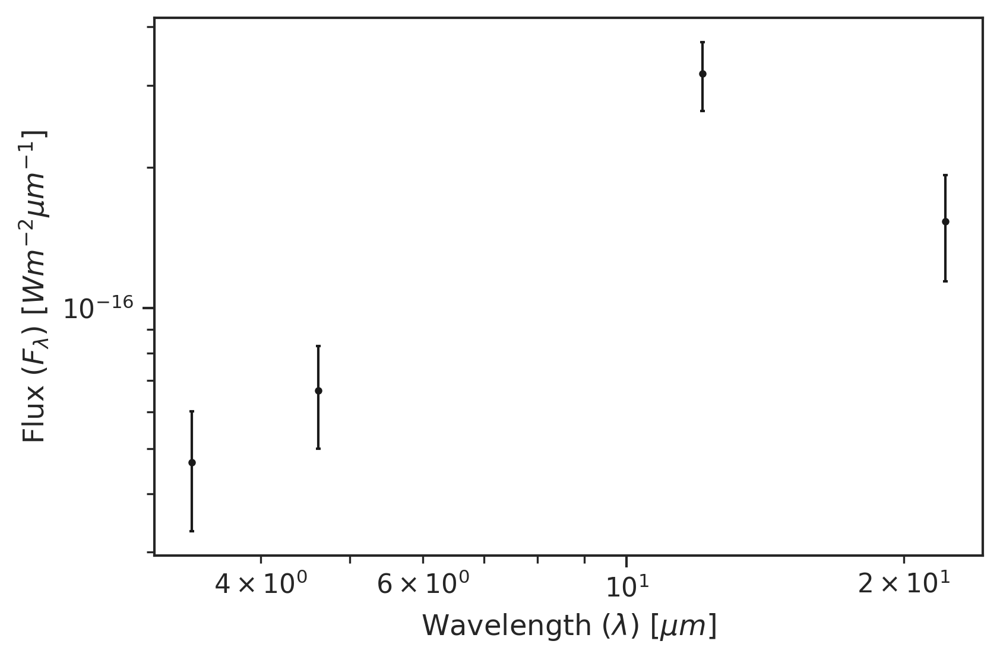

In [11]:
fig, ax = plt.subplots(1, 1, dpi=DPI)
plotObservations(obs, data, ax=ax, plotMedian=True)

## Run 0 - Constant Emissivity
Fit Parameters: [logD, logT1, eps]  
fitFilters = "all"

In [12]:
dataDict["run0"] = data.copy()

runDict["run0"] = {
    "fitParameters" : ["logT1", "logD", "eps"],
    "emissivitySpecification" : None,
    "albedoSpecification": "auto",
    "fitFilters" : "all",
    "columnMapping" : {
                "obs_id" : "obs_id",
                "designation" : "designation",
                "exp_mjd" : "mjd",
                "r_au" : "r_au",
                "delta_au" : "delta_au",
                "alpha_rad" : "alpha_rad",
                "eps" : None,
                "p" : None,
                "G" : "G",
                "logT1" : None,
                "logD" : None,
                "flux_si" : ["flux_W1_si", "flux_W2_si", "flux_W3_si", "flux_W4_si"],
                "fluxErr_si" : ["fluxErr_W1_si", "fluxErr_W2_si", "fluxErr_W3_si", "fluxErr_W4_si"],  
                "mag" : ["mag_W1", "mag_W2", "mag_W3", "mag_W4"],
                "magErr" : ["magErr_W1", "magErr_W2", "magErr_W3", "magErr_W4"]
    }
}

## Run 1 - 3 Parameters
Fit Parameters: [logD, logT1, eps_W1W2]  
fitFilters = "all"  
eps_W3 = 0.9  
eps_W4 = 0.9

In [13]:
dataDict["run1"] = data.copy()
dataDict["run1"]["eps_W3W4"] = np.ones(len(data)) * 0.9

runDict["run1"] = {
    "fitParameters" : ["logT1", "logD", "eps_W1W2"],
    "emissivitySpecification" : {
                "eps_W1W2" : ["W1","W2"],
                "eps_W3W4" : ["W3","W4"]},
    "albedoSpecification": "auto",
    "fitFilters" : "all",
    "columnMapping" : {
                "obs_id" : "obs_id",
                "designation" : "designation",
                "exp_mjd" : "mjd",
                "r_au" : "r_au",
                "delta_au" : "delta_au",
                "alpha_rad" : "alpha_rad",
                "eps" : ["eps_W3W4"],
                "p" : None,
                "G" : "G",
                "logT1" : None,
                "logD" : None,
                "flux_si" : ["flux_W1_si", "flux_W2_si", "flux_W3_si", "flux_W4_si"],
                "fluxErr_si" : ["fluxErr_W1_si", "fluxErr_W2_si", "fluxErr_W3_si", "fluxErr_W4_si"],
                "mag" : ["mag_W1", "mag_W2", "mag_W3", "mag_W4"],
                "magErr" : ["magErr_W1", "magErr_W2", "magErr_W3", "magErr_W4"]
    }
}

## Run 2a - Track 1, 3 parameters
Fit Parameters: [logD, logT1, eps_W1W2]  
eps_W3 = 0.70  
eps_W4 = 0.86  
fitFilters = "all"  

In [14]:
dataDict["run2a"] = data.copy()
dataDict["run2a"]["eps_W3"] = np.ones(len(data)) * 0.70
dataDict["run2a"]["eps_W4"] = np.ones(len(data)) * 0.86

runDict["run2a"] = {
    "fitParameters" : ["logT1", "logD", "eps_W1W2"],
    "emissivitySpecification" : {
                "eps_W1W2" : ["W1","W2"],
                "eps_W3" : ["W3"],
                "eps_W4" : ["W4"]},
    "albedoSpecification": "auto",
    "fitFilters" : "all",
    "columnMapping" : {
                "obs_id" : "obs_id",
                "designation" : "designation",
                "exp_mjd" : "mjd",
                "r_au" : "r_au",
                "delta_au" : "delta_au",
                "alpha_rad" : "alpha_rad",
                "eps" : ["eps_W3", "eps_W4"],
                "p" : None,
                "G" : "G",
                "logT1" : None,
                "logD" : None,
                "flux_si" : ["flux_W1_si", "flux_W2_si", "flux_W3_si", "flux_W4_si"],
                "fluxErr_si" : ["fluxErr_W1_si", "fluxErr_W2_si", "fluxErr_W3_si", "fluxErr_W4_si"],
                "mag" : ["mag_W1", "mag_W2", "mag_W3", "mag_W4"],
                "magErr" : ["magErr_W1", "magErr_W2", "magErr_W3", "magErr_W4"]
    }
}

## Run 2b - Track 1, 4 parameters
Fit Parameters: [logD, logT1, eps_W1, eps_W2]  
eps_W3 = 0.70  
eps_W4 = 0.86  
fitFilters = "all"  

In [15]:
dataDict["run2b"] = data.copy()
dataDict["run2b"]["eps_W3"] = np.ones(len(data)) * 0.70
dataDict["run2b"]["eps_W4"] = np.ones(len(data)) * 0.86

runDict["run2b"] = {
    "fitParameters" : ["logT1", "logD", "eps_W1", "eps_W2"],
    "emissivitySpecification" : "perBand",
    "albedoSpecification": "auto",
    "fitFilters" : "all",
    "columnMapping" : {
                "obs_id" : "obs_id",
                "designation" : "designation",
                "exp_mjd" : "mjd",
                "r_au" : "r_au",
                "delta_au" : "delta_au",
                "alpha_rad" : "alpha_rad",
                "eps" : ["eps_W3", "eps_W4"],
                "p" : None,
                "G" : "G",
                "logT1" : None,
                "logD" : None,
                "flux_si" : ["flux_W1_si", "flux_W2_si", "flux_W3_si", "flux_W4_si"],
                "fluxErr_si" : ["fluxErr_W1_si", "fluxErr_W2_si", "fluxErr_W3_si", "fluxErr_W4_si"],  
                "mag" : ["mag_W1", "mag_W2", "mag_W3", "mag_W4"],
                "magErr" : ["magErr_W1", "magErr_W2", "magErr_W3", "magErr_W4"]
    }
}

## Run 3a - Track 2, 3 parameters
Fit Parameters: [logD, logT1, eps_W1W2]  
eps_W3 = 0.76  
eps_W4 = 0.93  
fitFilters = "all"  

In [16]:
dataDict["run3a"] = data.copy()
dataDict["run3a"]["eps_W3"] = np.ones(len(data)) * 0.76
dataDict["run3a"]["eps_W4"] = np.ones(len(data)) * 0.93

runDict["run3a"] = {
    "fitParameters" : ["logT1", "logD", "eps_W1W2"],
    "emissivitySpecification" : {
                "eps_W1W2" : ["W1","W2"],
                "eps_W3" : ["W3"],
                "eps_W4" : ["W4"]},
    "albedoSpecification": "auto",
    "fitFilters" : "all",
    "columnMapping" : {
                "obs_id" : "obs_id",
                "designation" : "designation",
                "exp_mjd" : "mjd",
                "r_au" : "r_au",
                "delta_au" : "delta_au",
                "alpha_rad" : "alpha_rad",
                "eps" : ["eps_W3", "eps_W4"],
                "p" : None,
                "G" : "G",
                "logT1" : None,
                "logD" : None,
                "flux_si" : ["flux_W1_si", "flux_W2_si", "flux_W3_si", "flux_W4_si"],
                "fluxErr_si" : ["fluxErr_W1_si", "fluxErr_W2_si", "fluxErr_W3_si", "fluxErr_W4_si"],  
                "mag" : ["mag_W1", "mag_W2", "mag_W3", "mag_W4"],
                "magErr" : ["magErr_W1", "magErr_W2", "magErr_W3", "magErr_W4"]
    }
}

## Run 3b - Track 2, 4 parameters
Fit Parameters: [logD, logT1, eps_W1, eps_W2]  
eps_W3 = 0.76  
eps_W4 = 0.93  
fitFilters = "all"  

In [17]:
dataDict["run3b"] = data.copy()
dataDict["run3b"]["eps_W3"] = np.ones(len(data)) * 0.76
dataDict["run3b"]["eps_W4"] = np.ones(len(data)) * 0.93

runDict["run3b"] = {
    "fitParameters" : ["logT1", "logD", "eps_W1", "eps_W2"],
    "emissivitySpecification" : "perBand",
    "albedoSpecification": "auto",
    "fitFilters" : "all",
    "columnMapping" : {
                "obs_id" : "obs_id",
                "designation" : "designation",
                "exp_mjd" : "mjd",
                "r_au" : "r_au",
                "delta_au" : "delta_au",
                "alpha_rad" : "alpha_rad",
                "eps" : ["eps_W3", "eps_W4"],
                "p" : None,
                "G" : "G",
                "logT1" : None,
                "logD" : None,
                "flux_si" : ["flux_W1_si", "flux_W2_si", "flux_W3_si", "flux_W4_si"],
                "fluxErr_si" : ["fluxErr_W1_si", "fluxErr_W2_si", "fluxErr_W3_si", "fluxErr_W4_si"],  
                "mag" : ["mag_W1", "mag_W2", "mag_W3", "mag_W4"],
                "magErr" : ["magErr_W1", "magErr_W2", "magErr_W3", "magErr_W4"]
    }
}

## Run 4a - Track 3, 3 parameters
Fit Parameters: [logD, logT1, eps_W1W2]  
eps_W3 = 0.80  
eps_W4 = 0.98  
fitFilters = "all"  

In [18]:
dataDict["run4a"] = data.copy()
dataDict["run4a"]["eps_W3"] = np.ones(len(data)) * 0.80
dataDict["run4a"]["eps_W4"] = np.ones(len(data)) * 0.98

runDict["run4a"] = {
    "fitParameters" : ["logT1", "logD", "eps_W1W2"],
    "emissivitySpecification" : {
                "eps_W1W2" : ["W1","W2"],
                "eps_W3" : ["W3"],
                "eps_W4" : ["W4"]},
    "albedoSpecification": "auto",
    "fitFilters" : "all",
    "columnMapping" : {
                "obs_id" : "obs_id",
                "designation" : "designation",
                "exp_mjd" : "mjd",
                "r_au" : "r_au",
                "delta_au" : "delta_au",
                "alpha_rad" : "alpha_rad",
                "eps" : ["eps_W3", "eps_W4"],
                "p" : None,
                "G" : "G",
                "logT1" : None,
                "logD" : None,
                "flux_si" : ["flux_W1_si", "flux_W2_si", "flux_W3_si", "flux_W4_si"],
                "fluxErr_si" : ["fluxErr_W1_si", "fluxErr_W2_si", "fluxErr_W3_si", "fluxErr_W4_si"],  
                "mag" : ["mag_W1", "mag_W2", "mag_W3", "mag_W4"],
                "magErr" : ["magErr_W1", "magErr_W2", "magErr_W3", "magErr_W4"]
    }
}

## Run 4b - Track 3, 4 parameters
Fit Parameters: [logD, logT1, eps_W1, eps_W2]  
eps_W3 = 0.80  
eps_W4 = 0.98  
fitFilters = "all"  

In [19]:
dataDict["run4b"] = data.copy()
dataDict["run4b"]["eps_W3"] = np.ones(len(data)) * 0.80
dataDict["run4b"]["eps_W4"] = np.ones(len(data)) * 0.98

runDict["run4b"] = {
    "fitParameters" : ["logT1", "logD", "eps_W1", "eps_W2"],
    "emissivitySpecification" : "perBand",
    "albedoSpecification": "auto",
    "fitFilters" : "all",
    "columnMapping" : {
                "obs_id" : "obs_id",
                "designation" : "designation",
                "exp_mjd" : "mjd",
                "r_au" : "r_au",
                "delta_au" : "delta_au",
                "alpha_rad" : "alpha_rad",
                "eps" : ["eps_W3", "eps_W4"],
                "p" : None,
                "G" : "G",
                "logT1" : None,
                "logD" : None,
                "flux_si" : ["flux_W1_si", "flux_W2_si", "flux_W3_si", "flux_W4_si"],
                "fluxErr_si" : ["fluxErr_W1_si", "fluxErr_W2_si", "fluxErr_W3_si", "fluxErr_W4_si"],  
                "mag" : ["mag_W1", "mag_W2", "mag_W3", "mag_W4"],
                "magErr" : ["magErr_W1", "magErr_W2", "magErr_W3", "magErr_W4"]
    }
}

## Run 5a - NEOWISE
Fit Parameters: [logD, logT1, p_W1W2]  
eps_W1 = 0.9  
eps_W2 = 0.9  
eps_W3 = 0.9  
eps_W4 = 0.9  
p_W3 = 0.0  
p_W4 = 0.0   
fitFilters = "all"    

In [20]:
dataDict["run5a"] = data.copy()
dataDict["run5a"]["eps"] = np.ones(len(data)) * 0.9
dataDict["run5a"]["p_W3"] = np.ones(len(data)) * 0.0
dataDict["run5a"]["p_W4"] = np.ones(len(data)) * 0.0

runDict["run5a"] = {
    "fitParameters" : ["logT1", "logD", "p_W1W2"],
    "emissivitySpecification" : None,
    "albedoSpecification": {
                "p_W1W2" : ["W1", "W2"],
                "p_W3" : ["W3"],
                "p_W4" : ["W4"]},
    "fitFilters" : "all",
    "columnMapping" : {
                "obs_id" : "obs_id",
                "designation" : "designation",
                "exp_mjd" : "mjd",
                "r_au" : "r_au",
                "delta_au" : "delta_au",
                "alpha_rad" : "alpha_rad",
                "eps" : "eps",
                "p" : ["p_W3", "p_W4"],
                "G" : "G",
                "logT1" : None,
                "logD" : None,
                "flux_si" : ["flux_W1_si", "flux_W2_si", "flux_W3_si", "flux_W4_si"],
                "fluxErr_si" : ["fluxErr_W1_si", "fluxErr_W2_si", "fluxErr_W3_si", "fluxErr_W4_si"],  
                "mag" : ["mag_W1", "mag_W2", "mag_W3", "mag_W4"],
                "magErr" : ["magErr_W1", "magErr_W2", "magErr_W3", "magErr_W4"]
    }
}

## Run 5b - NEOWISE (Ignoring W2)
Fit Parameters: [logD, logT1, p_W1W2]  
eps_W1 = 0.9  
eps_W2 = 0.9  
eps_W3 = 0.9  
eps_W4 = 0.9  
p_W3 = 0.0  
p_W4 = 0.0   
fitFilters = ["W1", "W3", "W4"]

In [21]:
dataDict["run5b"] = data.copy()
dataDict["run5b"]["eps"] = np.ones(len(data)) * 0.9
dataDict["run5b"]["p_W3"] = np.ones(len(data)) * 0.0
dataDict["run5b"]["p_W4"] = np.ones(len(data)) * 0.0

runDict["run5b"] = {
    "fitParameters" : ["logT1", "logD", "p_W1W2"],
    "emissivitySpecification" : None,
    "albedoSpecification": {
                "p_W1W2" : ["W1", "W2"],
                "p_W3" : ["W3"],
                "p_W4" : ["W4"]},
    "fitFilters" : ["W1", "W3", "W4"],
    "columnMapping" : {
                "obs_id" : "obs_id",
                "designation" : "designation",
                "exp_mjd" : "mjd",
                "r_au" : "r_au",
                "delta_au" : "delta_au",
                "alpha_rad" : "alpha_rad",
                "eps" : "eps",
                "p" : ["p_W3", "p_W4"],
                "G" : "G",
                "logT1" : None,
                "logD" : None,
                "flux_si" : ["flux_W1_si", "flux_W2_si", "flux_W3_si", "flux_W4_si"],
                "fluxErr_si" : ["fluxErr_W1_si", "fluxErr_W2_si", "fluxErr_W3_si", "fluxErr_W4_si"],  
                "mag" : ["mag_W1", "mag_W2", "mag_W3", "mag_W4"],
                "magErr" : ["magErr_W1", "magErr_W2", "magErr_W3", "magErr_W4"]
    }
}

## Run Fits

Calculating number of fits to run...
Fit code: run0
Number of fits to run: 1

Fit code: run1
Number of fits to run: 1

Fit code: run2a
Number of fits to run: 1

Fit code: run2b
Number of fits to run: 1

Fit code: run3a
Number of fits to run: 1

Fit code: run3b
Number of fits to run: 1

Fit code: run4a
Number of fits to run: 1

Fit code: run4b
Number of fits to run: 1

Fit code: run5a
Number of fits to run: 1

Fit code: run5b
Number of fits to run: 1

Total number of fits to run: 10

Starting fit code: run0

Fitting object 54789 (1/1)...
Fit number: 1/10

Fitting 54789 with NEATM...
Fit Code: run0
Fit Parameters: ['logT1', 'logD', 'eps']
Emissivity Parameters: ['eps']
Emissivity Specification: None
Albedo Parameters: ['p']
Albedo Specification: auto
Number of observations: 46
Chains: 20
Samples per Chain: 3500
Burn-in Samples: 500
Effective Samples per Chain: 3000
Threads: 20


Multiprocess sampling (20 chains in 20 jobs)
CompoundStep
>Metropolis: [eps]
>Metropolis: [logT1]
>Metropolis: [logD]
Sampling 20 chains: 100%|██████████| 70000/70000 [00:34<00:00, 247.91draws/s]
The number of effective samples is smaller than 10% for some parameters.


Found best fit parameters:
 logT1: 2.558 +- 0.004
 logD:  3.240 +- 0.009
 eps:   0.740 +- 0.011
Total time: 60.68 seconds
Done.

Completed. Traces have the desired number of samples.
Saving results to database (54789/run0/atm_results_run0.db)...
Done.

Starting fit code: run1

Fitting object 54789 (1/1)...
Fit number: 2/10

Fitting 54789 with NEATM...
Fit Code: run1
Fit Parameters: ['logT1', 'logD', 'eps_W1W2']
Emissivity Parameters: ['eps_W1W2' 'eps_W3W4']
Emissivity Specification: {'eps_W1W2': ['W1', 'W2'], 'eps_W3W4': ['W3', 'W4']}
Albedo Parameters: ['p_W1W2' 'p_W3W4']
Albedo Specification: auto
Number of observations: 46
Chains: 20
Samples per Chain: 3500
Burn-in Samples: 500
Effective Samples per Chain: 3000
Threads: 20


Multiprocess sampling (20 chains in 20 jobs)
CompoundStep
>Metropolis: [eps_W1W2]
>Metropolis: [logT1]
>Metropolis: [logD]
Sampling 20 chains: 100%|██████████| 70000/70000 [00:33<00:00, 2091.75draws/s]
The number of effective samples is smaller than 10% for some parameters.


Found best fit parameters:
 logT1:    2.574 +- 0.006
 logD:     3.168 +- 0.014
 eps_W1W2: 0.656 +- 0.025
Total time: 48.61 seconds
Done.

Completed. Traces have the desired number of samples.
Saving results to database (54789/run1/atm_results_run1.db)...
Done.

Starting fit code: run2a

Fitting object 54789 (1/1)...
Fit number: 3/10

Fitting 54789 with NEATM...
Fit Code: run2a
Fit Parameters: ['logT1', 'logD', 'eps_W1W2']
Emissivity Parameters: ['eps_W1W2' 'eps_W3' 'eps_W4']
Emissivity Specification: {'eps_W1W2': ['W1', 'W2'], 'eps_W3': ['W3'], 'eps_W4': ['W4']}
Albedo Parameters: ['p_W1W2' 'p_W3' 'p_W4']
Albedo Specification: auto
Number of observations: 46
Chains: 20
Samples per Chain: 3500
Burn-in Samples: 500
Effective Samples per Chain: 3000
Threads: 20


Multiprocess sampling (20 chains in 20 jobs)
CompoundStep
>Metropolis: [eps_W1W2]
>Metropolis: [logT1]
>Metropolis: [logD]
Sampling 20 chains: 100%|██████████| 70000/70000 [00:33<00:00, 2074.19draws/s]
The number of effective samples is smaller than 10% for some parameters.


Found best fit parameters:
 logT1:    2.563 +- 0.004
 logD:     3.230 +- 0.011
 eps_W1W2: 0.736 +- 0.018
Total time: 50.14 seconds
Done.

Completed. Traces have the desired number of samples.
Saving results to database (54789/run2a/atm_results_run2a.db)...
Done.

Starting fit code: run2b

Fitting object 54789 (1/1)...
Fit number: 4/10

Fitting 54789 with NEATM...
Fit Code: run2b
Fit Parameters: ['logT1', 'logD', 'eps_W1', 'eps_W2']
Emissivity Parameters: ['eps_W1' 'eps_W2' 'eps_W3' 'eps_W4']
Emissivity Specification: perBand
Albedo Parameters: ['p_W1' 'p_W2' 'p_W3' 'p_W4']
Albedo Specification: auto
Number of observations: 46
Chains: 20
Samples per Chain: 3500
Burn-in Samples: 500
Effective Samples per Chain: 3000
Threads: 20


Multiprocess sampling (20 chains in 20 jobs)
CompoundStep
>Metropolis: [eps_W2]
>Metropolis: [eps_W1]
>Metropolis: [logT1]
>Metropolis: [logD]
Sampling 20 chains: 100%|██████████| 70000/70000 [00:41<00:00, 1706.99draws/s]
The gelman-rubin statistic is larger than 1.05 for some parameters. This indicates slight problems during sampling.
The estimated number of effective samples is smaller than 200 for some parameters.


Found best fit parameters:
 logT1:  2.556 +- 0.016
 logD:   3.248 +- 0.032
 eps_W1: 0.754 +- 0.029
 eps_W2: 0.391 +- 0.398
Total time: 63.53 seconds
Done.

Completed. Traces have the desired number of samples.
Saving results to database (54789/run2b/atm_results_run2b.db)...
Done.

Starting fit code: run3a

Fitting object 54789 (1/1)...
Fit number: 5/10

Fitting 54789 with NEATM...
Fit Code: run3a
Fit Parameters: ['logT1', 'logD', 'eps_W1W2']
Emissivity Parameters: ['eps_W1W2' 'eps_W3' 'eps_W4']
Emissivity Specification: {'eps_W1W2': ['W1', 'W2'], 'eps_W3': ['W3'], 'eps_W4': ['W4']}
Albedo Parameters: ['p_W1W2' 'p_W3' 'p_W4']
Albedo Specification: auto
Number of observations: 46
Chains: 20
Samples per Chain: 3500
Burn-in Samples: 500
Effective Samples per Chain: 3000
Threads: 20


Multiprocess sampling (20 chains in 20 jobs)
CompoundStep
>Metropolis: [eps_W1W2]
>Metropolis: [logT1]
>Metropolis: [logD]
Sampling 20 chains: 100%|██████████| 70000/70000 [00:36<00:00, 1927.89draws/s]
The number of effective samples is smaller than 10% for some parameters.


Found best fit parameters:
 logT1:    2.571 +- 0.005
 logD:     3.197 +- 0.012
 eps_W1W2: 0.696 +- 0.022
Total time: 53.86 seconds
Done.

Completed. Traces have the desired number of samples.
Saving results to database (54789/run3a/atm_results_run3a.db)...
Done.

Starting fit code: run3b

Fitting object 54789 (1/1)...
Fit number: 6/10

Fitting 54789 with NEATM...
Fit Code: run3b
Fit Parameters: ['logT1', 'logD', 'eps_W1', 'eps_W2']
Emissivity Parameters: ['eps_W1' 'eps_W2' 'eps_W3' 'eps_W4']
Emissivity Specification: perBand
Albedo Parameters: ['p_W1' 'p_W2' 'p_W3' 'p_W4']
Albedo Specification: auto
Number of observations: 46
Chains: 20
Samples per Chain: 3500
Burn-in Samples: 500
Effective Samples per Chain: 3000
Threads: 20


Multiprocess sampling (20 chains in 20 jobs)
CompoundStep
>Metropolis: [eps_W2]
>Metropolis: [eps_W1]
>Metropolis: [logT1]
>Metropolis: [logD]
Sampling 20 chains: 100%|██████████| 70000/70000 [00:46<00:00, 1500.49draws/s]
The number of effective samples is smaller than 10% for some parameters.


Found best fit parameters:
 logT1:  2.569 +- 0.005
 logD:   3.200 +- 0.013
 eps_W1: 0.696 +- 0.021
 eps_W2: 0.780 +- 0.166
Total time: 69.65 seconds
Done.

Completed. Traces have the desired number of samples.
Saving results to database (54789/run3b/atm_results_run3b.db)...
Done.

Starting fit code: run4a

Fitting object 54789 (1/1)...
Fit number: 7/10

Fitting 54789 with NEATM...
Fit Code: run4a
Fit Parameters: ['logT1', 'logD', 'eps_W1W2']
Emissivity Parameters: ['eps_W1W2' 'eps_W3' 'eps_W4']
Emissivity Specification: {'eps_W1W2': ['W1', 'W2'], 'eps_W3': ['W3'], 'eps_W4': ['W4']}
Albedo Parameters: ['p_W1W2' 'p_W3' 'p_W4']
Albedo Specification: auto
Number of observations: 46
Chains: 20
Samples per Chain: 3500
Burn-in Samples: 500
Effective Samples per Chain: 3000
Threads: 20


Multiprocess sampling (20 chains in 20 jobs)
CompoundStep
>Metropolis: [eps_W1W2]
>Metropolis: [logT1]
>Metropolis: [logD]
Sampling 20 chains: 100%|██████████| 70000/70000 [00:39<00:00, 1784.92draws/s]
The number of effective samples is smaller than 10% for some parameters.


Found best fit parameters:
 logT1:    2.576 +- 0.005
 logD:     3.176 +- 0.013
 eps_W1W2: 0.667 +- 0.025
Total time: 56.10 seconds
Done.

Completed. Traces have the desired number of samples.
Saving results to database (54789/run4a/atm_results_run4a.db)...
Done.

Starting fit code: run4b

Fitting object 54789 (1/1)...
Fit number: 8/10

Fitting 54789 with NEATM...
Fit Code: run4b
Fit Parameters: ['logT1', 'logD', 'eps_W1', 'eps_W2']
Emissivity Parameters: ['eps_W1' 'eps_W2' 'eps_W3' 'eps_W4']
Emissivity Specification: perBand
Albedo Parameters: ['p_W1' 'p_W2' 'p_W3' 'p_W4']
Albedo Specification: auto
Number of observations: 46
Chains: 20
Samples per Chain: 3500
Burn-in Samples: 500
Effective Samples per Chain: 3000
Threads: 20


Multiprocess sampling (20 chains in 20 jobs)
CompoundStep
>Metropolis: [eps_W2]
>Metropolis: [eps_W1]
>Metropolis: [logT1]
>Metropolis: [logD]
Sampling 20 chains: 100%|██████████| 70000/70000 [00:43<00:00, 1591.99draws/s]
The gelman-rubin statistic is larger than 1.05 for some parameters. This indicates slight problems during sampling.
The estimated number of effective samples is smaller than 200 for some parameters.


Found best fit parameters:
 logT1:  2.571 +- 0.005
 logD:   3.185 +- 0.012
 eps_W1: 0.674 +- 0.023
 eps_W2: 0.834 +- 0.144
Total time: 66.87 seconds
Done.

Completed. Traces have the desired number of samples.
Saving results to database (54789/run4b/atm_results_run4b.db)...
Done.

Starting fit code: run5a

Fitting object 54789 (1/1)...
Fit number: 9/10



/epyc/projects/atm/atm/atm/helpers.py:37: RuntimeWarning: 
                Potentially violating Kirchoff's law!
                Insure your albedo specification is compatible with your emissivity specification.
                You can also define one and set the other to 'auto'.
  You can also define one and set the other to 'auto'.""", RuntimeWarning)
/epyc/projects/atm/atm/atm/helpers.py:84: RuntimeWarning: 
                Potentially violating Kirchoff's law!
                Insure your albedo specification is compatible with your emissivity specification.
                You can also define one and set the other to 'auto'.
  You can also define one and set the other to 'auto'.""", RuntimeWarning)
/epyc/projects/atm/atm/atm/helpers.py:103: RuntimeWarning: Potentially violating Kirchoff's law!
  warnings.warn("Potentially violating Kirchoff's law!", RuntimeWarning)


Fitting 54789 with NEATM...
Fit Code: run5a
Fit Parameters: ['logT1', 'logD', 'p_W1W2']
Emissivity Parameters: ['eps']
Emissivity Specification: None
Albedo Parameters: ['p_W1W2' 'p_W3' 'p_W4']
Albedo Specification: {'p_W1W2': ['W1', 'W2'], 'p_W3': ['W3'], 'p_W4': ['W4']}
Number of observations: 46
Chains: 20
Samples per Chain: 3500
Burn-in Samples: 500
Effective Samples per Chain: 3000
Threads: 20


Multiprocess sampling (20 chains in 20 jobs)
CompoundStep
>Metropolis: [p_W1W2]
>Metropolis: [logT1]
>Metropolis: [logD]
Sampling 20 chains: 100%|██████████| 70000/70000 [00:34<00:00, 2036.11draws/s]
The number of effective samples is smaller than 10% for some parameters.


Found best fit parameters:
 logT1:  2.558 +- 0.004
 logD:   3.197 +- 0.011
 p_W1W2: 0.822 +- 0.049


/epyc/projects/atm/atm/atm/helpers.py:37: RuntimeWarning: 
                Potentially violating Kirchoff's law!
                Insure your albedo specification is compatible with your emissivity specification.
                You can also define one and set the other to 'auto'.
  You can also define one and set the other to 'auto'.""", RuntimeWarning)
/epyc/projects/atm/atm/atm/helpers.py:84: RuntimeWarning: 
                Potentially violating Kirchoff's law!
                Insure your albedo specification is compatible with your emissivity specification.
                You can also define one and set the other to 'auto'.
  You can also define one and set the other to 'auto'.""", RuntimeWarning)
/epyc/projects/atm/atm/atm/helpers.py:103: RuntimeWarning: Potentially violating Kirchoff's law!
  warnings.warn("Potentially violating Kirchoff's law!", RuntimeWarning)


Total time: 49.51 seconds
Done.

Completed. Traces have the desired number of samples.
Saving results to database (54789/run5a/atm_results_run5a.db)...
Done.

Starting fit code: run5b

Fitting object 54789 (1/1)...
Fit number: 10/10

Fitting 54789 with NEATM...
Fit Code: run5b
Fit Parameters: ['logT1', 'logD', 'p_W1W2']
Emissivity Parameters: ['eps']
Emissivity Specification: None
Albedo Parameters: ['p_W1W2' 'p_W3' 'p_W4']
Albedo Specification: {'p_W1W2': ['W1', 'W2'], 'p_W3': ['W3'], 'p_W4': ['W4']}
Number of observations: 46
Chains: 20
Samples per Chain: 3500
Burn-in Samples: 500
Effective Samples per Chain: 3000
Threads: 20


Multiprocess sampling (20 chains in 20 jobs)
CompoundStep
>Metropolis: [p_W1W2]
>Metropolis: [logT1]
>Metropolis: [logD]
Sampling 20 chains: 100%|██████████| 70000/70000 [00:35<00:00, 1964.63draws/s]
The gelman-rubin statistic is larger than 1.05 for some parameters. This indicates slight problems during sampling.
The number of effective samples is smaller than 10% for some parameters.


Found best fit parameters:
 logT1:  2.504 +- 0.011
 logD:   3.308 +- 0.024
 p_W1W2: 0.521 +- 0.059
Total time: 51.50 seconds
Done.

Completed. Traces have the desired number of samples.
Saving results to database (54789/run5b/atm_results_run5b.db)...
Done.



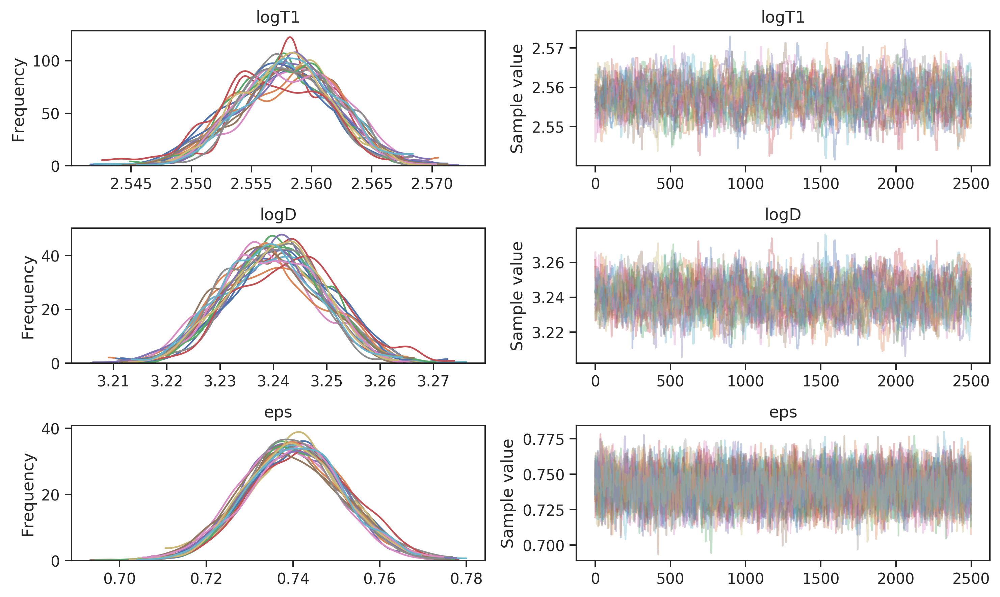

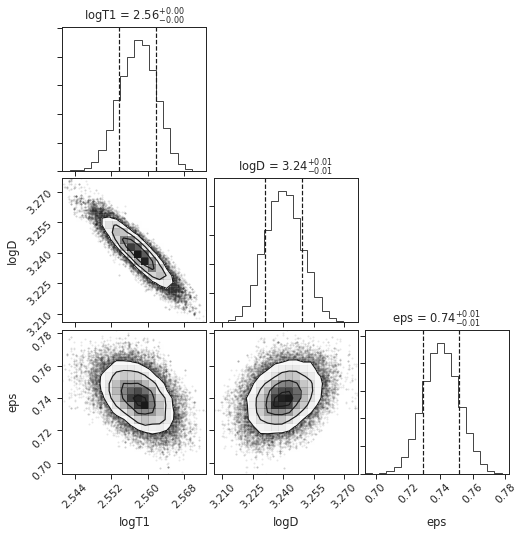

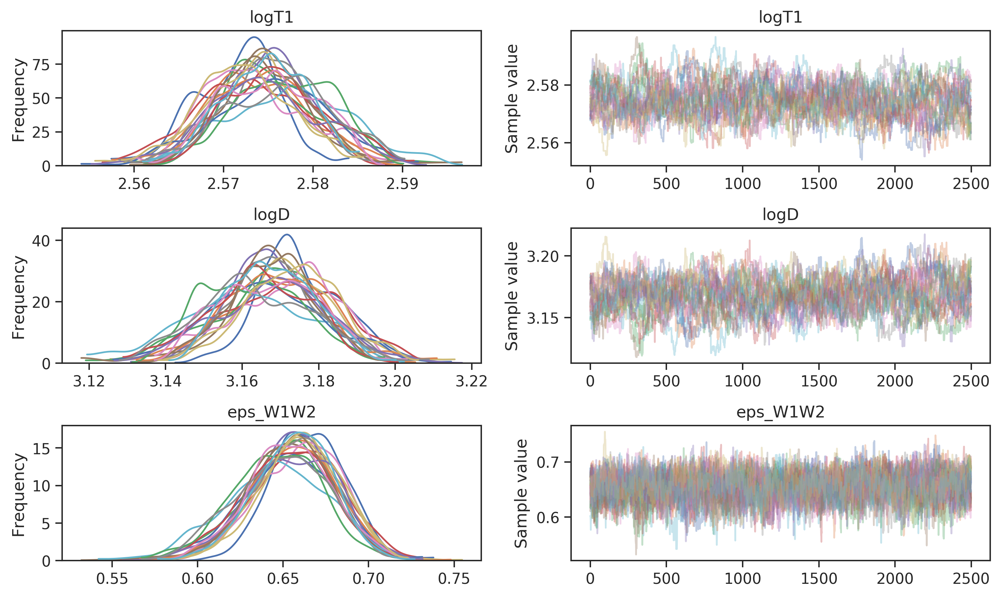

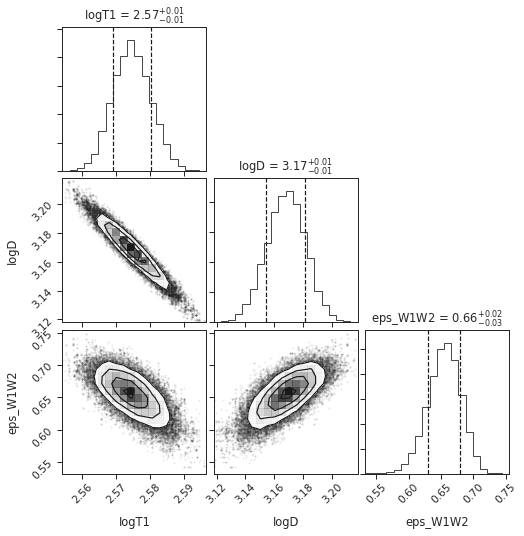

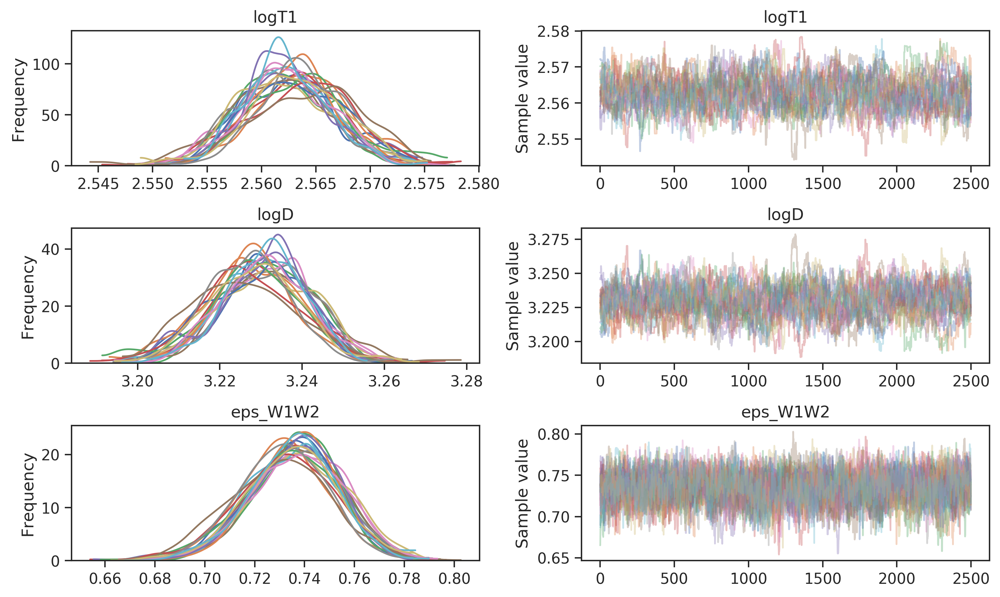

...

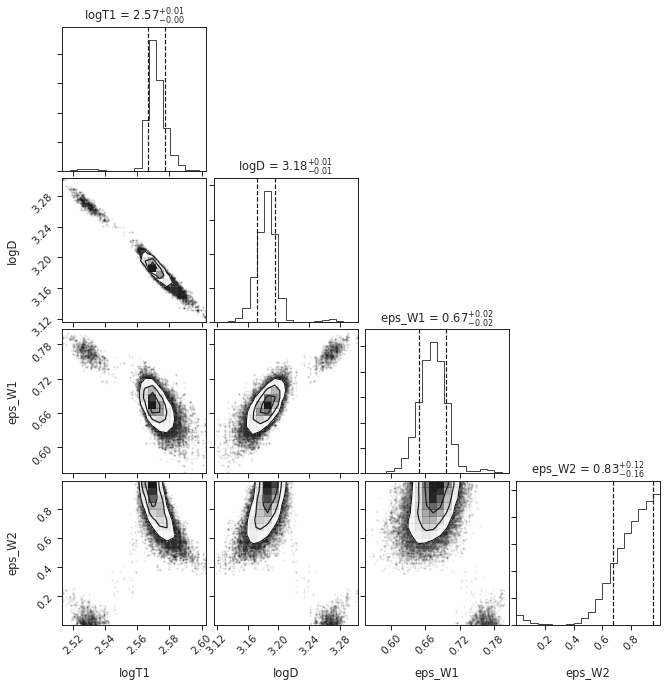

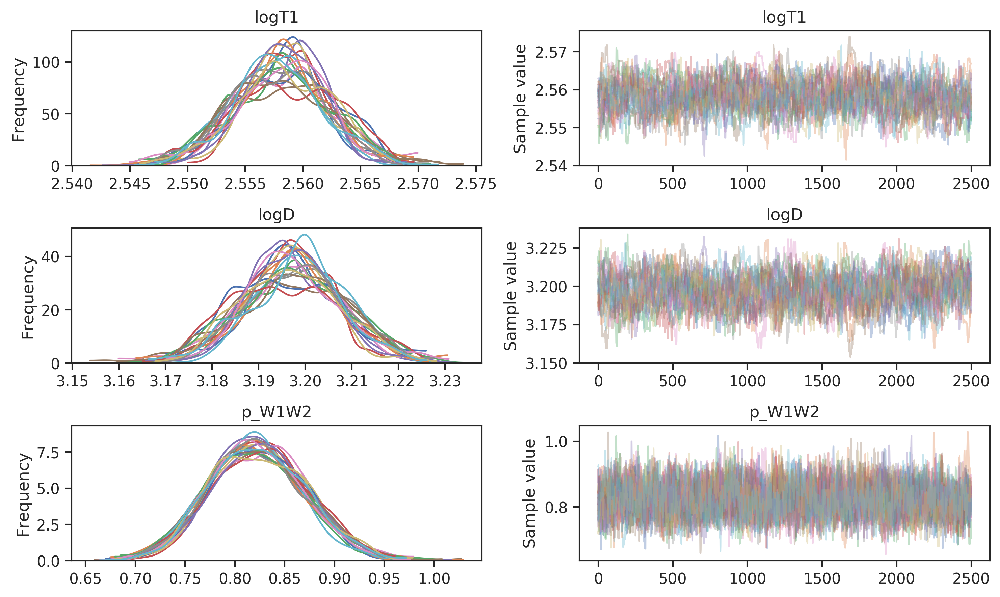

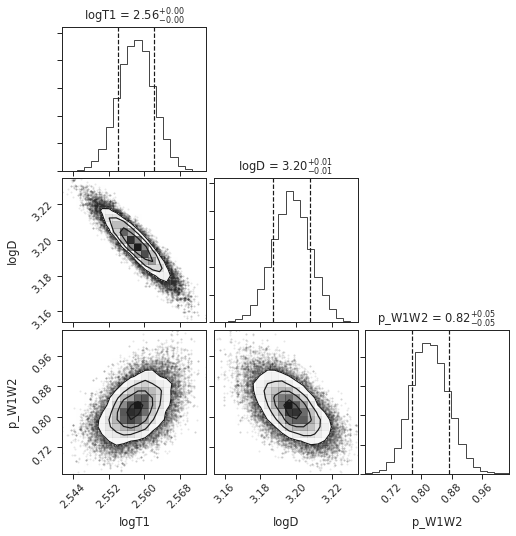

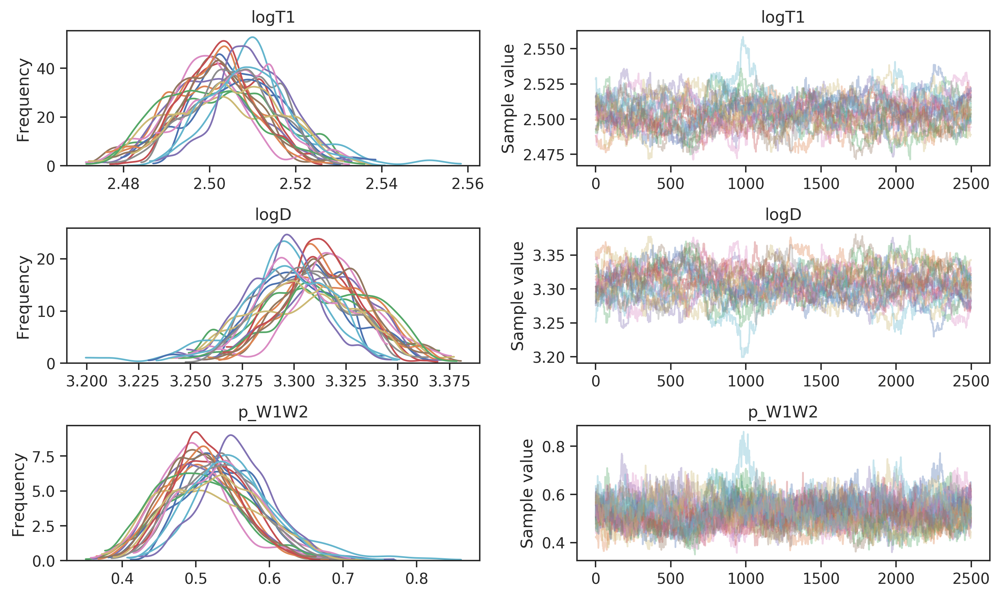

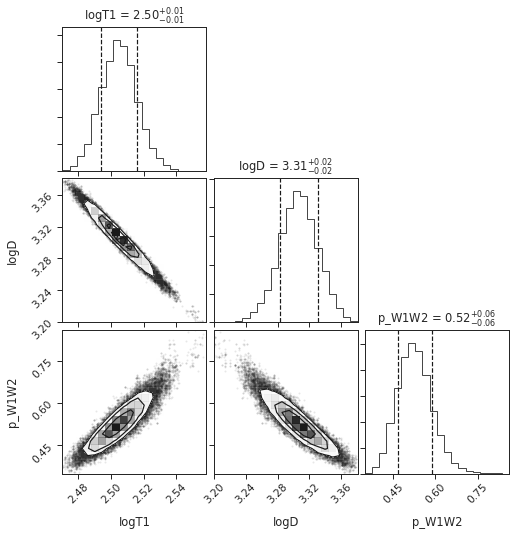

In [22]:
obs = WISE()
model = NEATM(verbose=False)

summary, model_observations = multiFit(model, obs, dataDict, runDict, fitConfig, 
                                       saveDir=asteroid_name)

In [23]:
summary

,designation,model,code,parameter,median,sigmaG,mean,sd,mc_error,n_eff,Rhat,hpd_2.5,hpd_97.5
0,54789,NEATM,run0,logT1,2.557955,0.004192,2.557883,0.004069,0.000121,1037.890213,1.007504,2.549938,2.565595
1,54789,NEATM,run0,logD,3.240061,0.009439,3.240076,0.009180,0.000269,1080.737589,1.007003,3.222059,3.257264
2,54789,NEATM,run0,eps,0.740394,0.011206,0.740467,0.011210,0.000186,3428.550346,1.002444,0.718350,0.762215
3,54789,NEATM,run1,logT1,2.574442,0.005793,2.574569,0.005751,0.000295,415.730864,1.030638,2.563901,2.586199
4,54789,NEATM,run1,logD,3.168297,0.013596,3.167975,0.013679,0.000706,416.252534,1.030259,3.140893,3.193971
5,54789,NEATM,run1,eps_W1W2,0.655841,0.025269,0.654742,0.025448,0.000985,751.426834,1.014573,0.604666,0.704172
6,54789,NEATM,run2a,logT1,2.562723,0.004467,2.562792,0.004430,0.000172,691.108058,1.019383,2.554631,2.571951
7,54789,NEATM,run2a,logD,3.229933,0.011265,3.229705,0.011409,0.000446,692.843505,1.018859,3.206901,3.251428
8,54789,NEATM,run2a,eps_W1W2,0.735641,0.018131,0.734875,0.018343,0.000558,1247.927568,1.010418,0.698011,0.769782
9,54789,NEATM,run2b,logT1,2.555556,0.015785,2.552996,0.012619,0.001038,99.637379,1.058745,2.530293,2.573162


In [24]:
observations_pp, model_observations_pp, observed_stats, model_stats = postProcess(obs, 
                                                                                  data,
                                                                                  model_observations, 
                                                                                  summary)

Calculating colors using these columns:
Magnitudes : mag_W1, mag_W2, mag_W3, mag_W4
Creating colors: W1-W2, W2-W3, W3-W4
Done.

Calculating model colors using these columns:
Model magnitudes : model_mag_W1, model_mag_W2, model_mag_W3, model_mag_W4
Creating model colors: model_W1-W2, model_W2-W3, model_W3-W4
Done.

Calculating color residuals using these columns:
Observed colors: W1-W2, W2-W3, W3-W4
Model colors : model_W1-W2, model_W2-W3, model_W3-W4
Creating residuals: residual_W1-W2, residual_W2-W3, residual_W3-W4
Done.

Calculating magnitude residuals using these columns:
Observed magnitudes : mag_W1, mag_W2, mag_W3, mag_W4
Model magnitudes : model_mag_W1, model_mag_W2, model_mag_W3, model_mag_W4
Creating residuals: residual_W1, residual_W2, residual_W3, residual_W4
Done.

Calculating chi squared using these columns:
Magnitude residuals : residual_W1, residual_W2, residual_W3, residual_W4
Magnitude errors : magErr_W1, magErr_W2, magErr_W3, magErr_W4
Creating chi2 columns: chi2_W1, c

In [25]:
model_stats[["code", "reduced_chi2"]]

,code,reduced_chi2
0,run0,2.029359
1,run1,2.223180
2,run2a,1.861046
3,run2b,1.953150
4,run3a,1.874286
5,run3b,1.886239
6,run4a,1.892846
7,run4b,1.892433
8,run5a,2.029062
9,run5b,4.347922


In [26]:
lambdaRange=[1.0e-6, 30e-6]
lambdaNum=250
lambdaEdges=[3.9e-6, 6.5e-6, 18.5e-6]

SEDs = {}
for code in runDict.keys():
    SEDs[code] = calcFluxLambdaSED(model, obs, dataDict[code], 
                                   summary=summary[summary["code"] == code], 
                                   fitParameters=runDict[code]["fitParameters"],
                                   emissivitySpecification=runDict[code]["emissivitySpecification"],
                                   albedoSpecification=runDict[code]["albedoSpecification"],
                                   columnMapping=runDict[code]["columnMapping"],
                                   lambdaRange=lambdaRange,
                                   lambdaNum=lambdaNum,
                                   lambdaEdges=lambdaEdges,
                                   linearInterpolation=False)

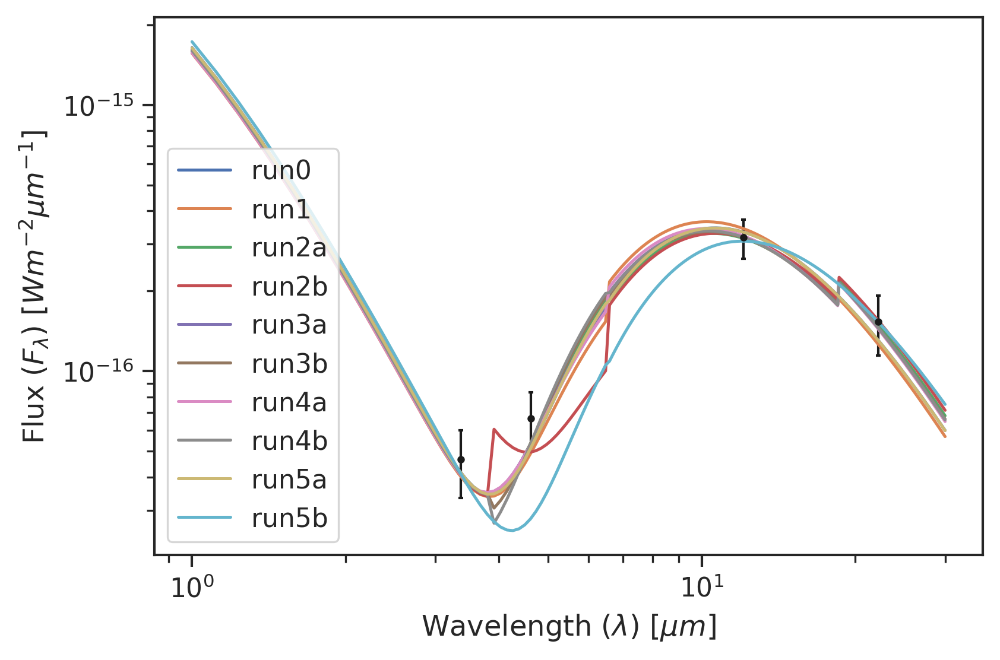

In [27]:
fig, ax = plt.subplots(1, 1, dpi=DPI)
plotObservations(obs, data, ax=ax, plotMedian=True)
for code in dataDict.keys():
    plotSED(SEDs[code], ax=ax, plotKwargs={"label": code})
ax.legend()

In [28]:
model_mapping = {
    "model 1" : "run0",
    "model 2" : "run1",
    "model 3" : "run3a",
    "model 4" : "run4a",
    "model 5" : "run4b",
}

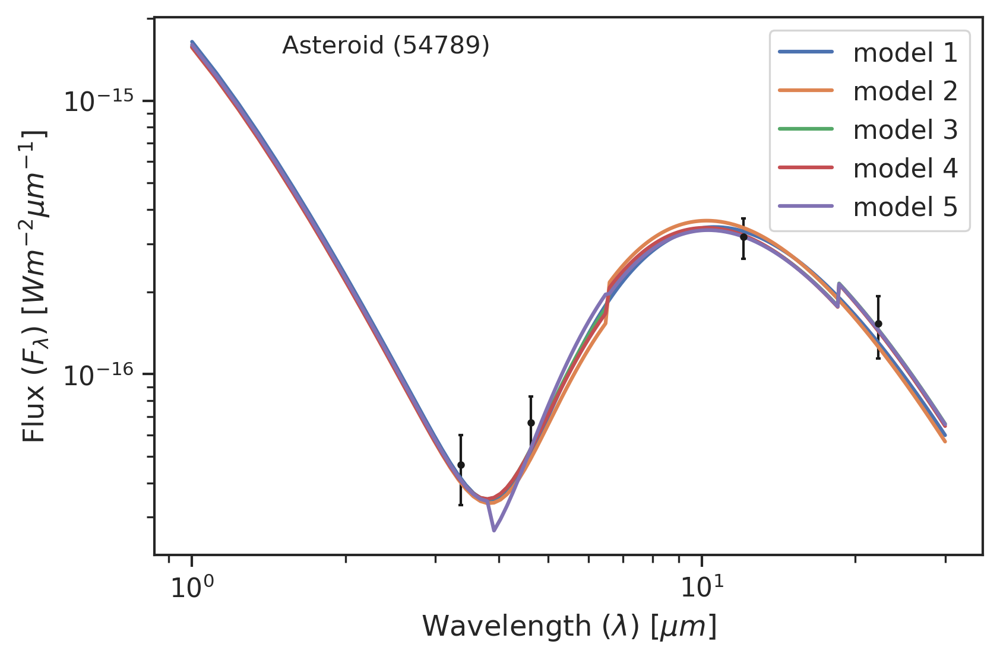

In [29]:
fig, ax = plt.subplots(1, 1, dpi=DPI)
plotObservations(obs, data, ax=ax, plotMedian=True)
for model_i in model_mapping.keys():
    plotSED(SEDs[model_mapping[model_i]], ax=ax, plotKwargs={"label": model_i, "lw" : 1.5})
ax.legend()
ax.text(1.5, 1.5*10**(-15), "Asteroid (54789)")
if SAVE_FIGS is True:
    fig.savefig(os.path.join(SAVE_DIR, "SEDs_{}.{}".format(asteroid_name, FORMAT)), bbox_inches='tight')

In [30]:
! mv 54789/run4b/54789/54789_run4b_NEATM_WISE_corner.png ../plots/
! mv 54789/run4a/54789/54789_run4a_NEATM_WISE_corner.png ../plots/

In [31]:
# Rotate summary table
summary_rotated = pd.pivot_table(summary, 
                                 values=["median", "sigmaG"], 
                                 index=['designation', 'code'],
                                 columns=['parameter'])
summary_rotated.columns = ['{1}_{0}'.format(col[0], col[1]) for col in summary_rotated.columns.values]
summary_rotated.reset_index(inplace=True)
summary_reduced = summary_rotated[summary_rotated["code"].isin(model_mapping.values())].copy()
summary_reduced["delta_D"] = 100 * (10**summary_reduced["logD_median"].values - 10**summary_reduced[summary_reduced["code"] == "run0"]["logD_median"].values) / 10**summary_reduced[summary_reduced["code"] == "run0"]["logD_median"].values
summary_reduced = summary_reduced[["designation", "code", "logD_median", "delta_D", "logT1_median", "eps_median", "eps_W1W2_median", "eps_W1_median", "eps_W2_median"]]
summary_reduced["p_median"] = (1 - summary_reduced["eps_median"].values) / calcQ(data["G"].values[0])
summary_reduced["p_W1W2_median"] = (1 - summary_reduced["eps_W1W2_median"].values) / calcQ(data["G"].values[0])
summary_reduced["p_W1_median"] = (1 - summary_reduced["eps_W1_median"].values) / calcQ(data["G"].values[0])
summary_reduced["p_W2_median"] = (1 - summary_reduced["eps_W2_median"].values) / calcQ(data["G"].values[0])
summary_reduced.reset_index(inplace=True, drop=True)
summary_reduced.to_csv("{}.csv".format(asteroid_name))

In [32]:
summary_reduced

,designation,code,logD_median,delta_D,logT1_median,eps_median,eps_W1W2_median,eps_W1_median,eps_W2_median,p_median,p_W1W2_median,p_W1_median,p_W2_median
0,54789,run0,3.240061,0.000000,2.557955,0.740394,NaN,NaN,NaN,0.675989,NaN,NaN,NaN
1,54789,run1,3.168297,-15.231198,2.574442,NaN,0.655841,NaN,NaN,NaN,0.896156,NaN,NaN
2,54789,run3a,3.197462,-9.343055,2.570799,NaN,0.695585,NaN,NaN,NaN,0.792667,NaN,NaN
3,54789,run4a,3.176153,-13.683992,2.576298,NaN,0.666822,NaN,NaN,NaN,0.867562,NaN,NaN
4,54789,run4b,3.184912,-11.925346,2.571054,NaN,NaN,0.67355,0.834296,NaN,NaN,0.850044,0.431477
